<div style="border-radius:10px;
            border:#0b0265 solid;
           background-color:#cccc00;
           font-size:110%;
           letter-spacing:0.5px;
            text-align: center">

<center><h1 style="padding: 25px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
Flight Price Prediction ✈ 🛬</h1></center>

</div>

<p align="center">
  <img width="600" height="300" src="https://www.savethestudent.org/uploads/flights.jpg">
</p>

# <a name="toc"></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
Table of Contents</h3></center>
</div>

- [1. Problem statement](#Problem_Statement)
    - [1.1. Introduction](#Introduction)
    - [1.2. Dataset Features](#Dataset_Features)
- [2. Import Libraries and Data](#Import_Libraries_and_Data)
- [3. Handling Missing Values](#Handling_Missing_Values)
- [4. Data Analysis and Visualization](#Data_Analysis_and_Visualization)
- [5. Outlier Detection](#Outlier_Detection)
- [6. Check for Rare Categories](#Check_for_Rare_Categories)
- [7. Categorical Variables Encoding](#Categorical_Variables_Encoding)
- [8. Dataset Splitting](#Dataset_Splitting)
- [9. Modeling and Parameter Optimization](#Modeling_and_Parameter_Optimization)
- [10. Feature Importance](#Feature_Importance)
- [11. Results](#Results)
- [12. Predictions](#Predictions)

# <a name='Problem_Statement'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
1. Problem Statement</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

## <a name='Introduction'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            letter-spacing:0.5px;">

<h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
1.1. Introduction</h3>
</div>

We are proposing a system that helps the user to predict the price of an airline ticket with optimum accuracy. In this case they can get the most cheapest flight ticket they can.

## <a name='Dataset_Features'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            letter-spacing:0.5px;">

<h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
1.2. Dataset Features</h3>
</div>

* `Airline`: The name of the airline company. It is a categorical feature having six different airlines.
* `Flight`: Airlines's flight code. It is a categorical feature.
* `Source City`: City from which the flight takes off. It is a categorical feature having six unique cities.
* `Departure Time`: This is a derived categorical feature obtained created by grouping time periods into bins. It stores information about the departure time and has 6 unique time labels.
* `Stops`: A categorical feature with three distinct values that stores the number of stops between the source and destination cities.
* `Arrival Time`: This is a derived categorical feature created by grouping time intervals into bins. It has six distinct time labels and keeps information about the arrival time.
* `Destination City`: City where the flight will land(end). It is a categorical feature having six unique cities.
* `Class`: A categorical feature that contains information on seat class; it has two distinct values: Business and Economy.
* `Duration`: A continuous feature that displays the overall amount of time it takes to travel between the source city and destination city in hours.
* `Days Left`: This is a derived characteristic that is calculated by subtracting the trip date by the booking date.
* **`Price`**: Ticket price in Indian Rupees(INR).

# <a name='Import_Libraries_and_Data'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
2. Import Libraries and Data</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
!pip install scikit-optimize

In [ ]:
# handle table-like data and matrices
import pandas as pd
import numpy as np

# visualisation
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# evaluations
from sklearn.model_selection import RandomizedSearchCV, cross_val_score
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# model
import statsmodels.api as sm
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor, ExtraTreesRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import LinearSVR
from xgboost import XGBRegressor

# baysian optimization
from skopt import gp_minimize # Bayesian Opt with GP
from skopt.plots import plot_convergence, plot_evaluations, plot_objective
from skopt.space import Integer
from skopt.utils import use_named_args

# ignore warnings
import warnings
warnings.filterwarnings('ignore')

# to display the total number columns present in the dataset
pd.set_option('display.max_columns', None)

In [ ]:
data = pd.read_csv('/content/Flight_data.csv')

# <a name='Handling_Missing_Values'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
3. Handling Missing Values</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
data = data.iloc[: , 1:]

let's find if we have missing values in the dataset.

In [ ]:
data.isnull().sum()

,0
airline,0
flight,0
source_city,0
departure_time,0
stops,0
arrival_time,0
destination_city,0
class,0
duration,0
days_left,0


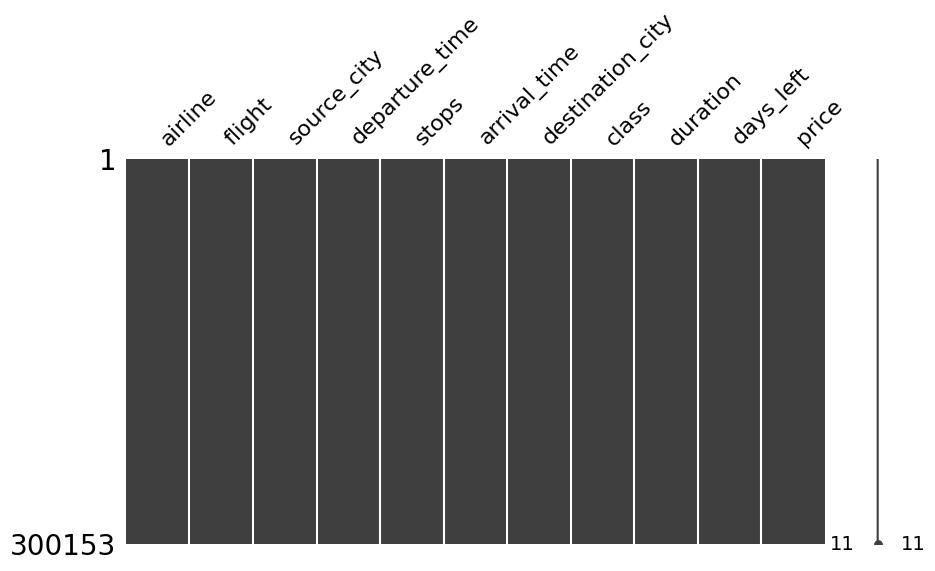

In [ ]:
msno.matrix(data, figsize=(10, 5));

let's find if we have duplicate rows.

In [ ]:
data.duplicated().sum()

0

# <a name='Data_Analysis_and_Visualization'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
4. Data Analysis and Visualization</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
data.head(3)

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956


In [ ]:
data.shape

(300153, 11)

There are 300153 rows and 11 features in the dataset.

In [ ]:
for i in data.columns[0:-3]:
  print(f'Number of categories in the variable {i}: {len(data[i].unique())}')

Number of categories in the variable airline: 6
Number of categories in the variable flight: 1561
Number of categories in the variable source_city: 6
Number of categories in the variable departure_time: 6
Number of categories in the variable stops: 3
Number of categories in the variable arrival_time: 6
Number of categories in the variable destination_city: 6
Number of categories in the variable class: 2


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300153 entries, 0 to 300152
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   airline           300153 non-null  object 
 1   flight            300153 non-null  object 
 2   source_city       300153 non-null  object 
 3   departure_time    300153 non-null  object 
 4   stops             300153 non-null  object 
 5   arrival_time      300153 non-null  object 
 6   destination_city  300153 non-null  object 
 7   class             300153 non-null  object 
 8   duration          300153 non-null  float64
 9   days_left         300153 non-null  int64  
 10  price             300153 non-null  int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 25.2+ MB


In [ ]:
data.describe()

,duration,days_left,price
count,300153.000000,300153.000000,300153.000000
mean,12.221021,26.004751,20889.660523
std,7.191997,13.561004,22697.767366
min,0.830000,1.000000,1105.000000
25%,6.830000,15.000000,4783.000000
50%,11.250000,26.000000,7425.000000
75%,16.170000,38.000000,42521.000000
max,49.830000,49.000000,123071.000000


In [ ]:
data.describe(include=object).T

,count,unique,top,freq
airline,300153,6,Vistara,127859
flight,300153,1561,UK-706,3235
source_city,300153,6,Delhi,61343
departure_time,300153,6,Morning,71146
stops,300153,3,one,250863
arrival_time,300153,6,Night,91538
destination_city,300153,6,Mumbai,59097
class,300153,2,Economy,206666


 The most expensive flight.

In [ ]:
data[data['price'] == data['price'].max()]

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
261377,Vistara,UK-772,Kolkata,Morning,one,Night,Delhi,Business,13.5,3,123071


 The cheapest flight.

In [ ]:
data[data['price'] == data['price'].min()]

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
203807,AirAsia,I5-517,Chennai,Morning,zero,Morning,Hyderabad,Economy,1.17,16,1105
203808,GO_FIRST,G8-505,Chennai,Evening,zero,Evening,Hyderabad,Economy,1.25,16,1105
203908,AirAsia,I5-517,Chennai,Morning,zero,Morning,Hyderabad,Economy,1.17,17,1105
203909,GO_FIRST,G8-505,Chennai,Evening,zero,Evening,Hyderabad,Economy,1.25,17,1105
204003,AirAsia,I5-517,Chennai,Morning,zero,Morning,Hyderabad,Economy,1.17,18,1105
...,...,...,...,...,...,...,...,...,...,...,...
206601,Indigo,6E-7261,Chennai,Morning,one,Evening,Hyderabad,Economy,7.92,49,1105
206602,Indigo,6E-611,Chennai,Evening,one,Late_Night,Hyderabad,Economy,8.25,49,1105
206603,Indigo,6E-581,Chennai,Morning,one,Evening,Hyderabad,Economy,9.17,49,1105
206604,Indigo,6E-7127,Chennai,Afternoon,one,Night,Hyderabad,Economy,9.50,49,1105


In [ ]:
df1 = pd.DataFrame()
df1['origin-destination'] = data['source_city'] + '_' + data['destination_city']

In [ ]:
len(df1['origin-destination'].unique())

30

In [ ]:
df1['origin-destination'].value_counts()

,count
origin-destination,
Delhi_Mumbai,15289
Mumbai_Delhi,14809
Delhi_Bangalore,14012
Bangalore_Delhi,13756
Bangalore_Mumbai,12939
Mumbai_Bangalore,12885
Mumbai_Kolkata,12602
Delhi_Kolkata,11934
Kolkata_Mumbai,11467


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['airline'].unique(), values=data['airline'].value_counts(), name='airline', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['gold', 'mediumturquoise','darkorange', 'lightgreen']), 1, 1)
fig.add_trace(go.Bar(x=data['airline'].unique(), y=data['airline'].value_counts(), name='Airline', text=data['airline'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='pink', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Airline Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Airline', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='airline', marginal='box', title='<b>Price Distribution w.r.t. Airline<b>')
fig.show()

In [ ]:
print('Mean ticket price for *SpiceJet* airline is:', round(np.mean(data[data['airline'] == 'SpiceJet']['price']), 2))
print('Mean ticket price for *AirAsia* airline is:', round(np.mean(data[data['airline'] == 'AirAsia']['price']), 2))
print('Mean ticket price for *Vistara* airline is:', round(np.mean(data[data['airline'] == 'Vistara']['price']), 2))
print('Mean ticket price for *GO_FIRST* airline is:', round(np.mean(data[data['airline'] == 'GO_FIRST']['price']), 2))
print('Mean ticket price for *Indigo* airline is:', round(np.mean(data[data['airline'] == 'Indigo']['price']), 2))
print('Mean ticket price for *Air_India* airline is:', round(np.mean(data[data['airline'] == 'Air_India']['price']), 2))

Mean ticket price for *SpiceJet* airline is: 6179.28
Mean ticket price for *AirAsia* airline is: 4091.07
Mean ticket price for *Vistara* airline is: 30396.54
Mean ticket price for *GO_FIRST* airline is: 5652.01
Mean ticket price for *Indigo* airline is: 5324.22
Mean ticket price for *Air_India* airline is: 23507.02


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['departure_time'].unique(), values=data['departure_time'].value_counts(), name='Departure Time', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2))), 1, 1)
fig.add_trace(go.Bar(x=data['departure_time'].unique(), y=data['departure_time'].value_counts(), name='Departure Time',
                     text=data['departure_time'].value_counts(), marker_line_color='black', marker_line_width=2, marker_color='yellow', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Departure Time Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Departure Time', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='departure_time', marginal='box', title='<b>Price Distribution w.r.t. Departure Time<b>')
fig.show()

In [ ]:
print('Mean ticket price for *Evening* departure time is:', round(np.mean(data[data['departure_time'] == 'Evening']['price']), 2))
print('Mean ticket price for *Early_Morning* departure time is:', round(np.mean(data[data['departure_time'] == 'Early_Morning']['price']), 2))
print('Mean ticket price for *Morning* departure time is:', round(np.mean(data[data['departure_time'] == 'Morning']['price']), 2))
print('Mean ticket price for *Afternoon* departure time is:', round(np.mean(data[data['departure_time'] == 'Afternoon']['price']), 2))
print('Mean ticket price for *Night* departure time is:', round(np.mean(data[data['departure_time'] == 'Night']['price']), 2))
print('Mean ticket price for *Late_Night* departure time is:', round(np.mean(data[data['departure_time'] == 'Late_Night']['price']), 2))

Mean ticket price for *Evening* departure time is: 21232.36
Mean ticket price for *Early_Morning* departure time is: 20370.68
Mean ticket price for *Morning* departure time is: 21630.76
Mean ticket price for *Afternoon* departure time is: 18179.2
Mean ticket price for *Night* departure time is: 23062.15
Mean ticket price for *Late_Night* departure time is: 9295.3


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['arrival_time'].unique(), values=data['arrival_time'].value_counts(), name='Arrival Time', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['#ff99ff', '#00ccff','darkorange', 'lightgreen']), 1, 1)
fig.add_trace(go.Bar(x=data['arrival_time'].unique(), y=data['arrival_time'].value_counts(), name='Arrival Time', text=data['arrival_time'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='#ccff99', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Arrival Time Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Arrival Time', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='arrival_time', marginal='box', title='<b>Price Distribution w.r.t. Arrival Time<b>')
fig.show()

In [ ]:
print('Mean ticket price for *Night* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Night']['price']), 2))
print('Mean ticket price for *Morning* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Morning']['price']), 2))
print('Mean ticket price for *Early_Morning* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Early_Morning']['price']), 2))
print('Mean ticket price for *Afternoon* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Afternoon']['price']), 2))
print('Mean ticket price for *Evening* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Evening']['price']), 2))
print('Mean ticket price for *Late_Night* arrival time is:', round(np.mean(data[data['arrival_time'] == 'Late_Night']['price']), 2))

Mean ticket price for *Night* arrival time is: 21586.76
Mean ticket price for *Morning* arrival time is: 22231.08
Mean ticket price for *Early_Morning* arrival time is: 14993.14
Mean ticket price for *Afternoon* arrival time is: 18494.6
Mean ticket price for *Evening* arrival time is: 23044.37
Mean ticket price for *Late_Night* arrival time is: 11284.91


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['stops'].unique(), values=data['stops'].value_counts(), name='Stops', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['#ccff33', '#00ccff','red']), 1, 1)
fig.add_trace(go.Bar(x=data['stops'].unique(), y=data['stops'].value_counts(), name='Stops', text=data['stops'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='#ffcc99', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Stops Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Stops', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='stops', marginal='box', title='<b>Price Distribution w.r.t. Stops<b>')
fig.show()

In [ ]:
print('Mean ticket price for *zero stop* is:', round(np.mean(data[data['stops'] == 'zero']['price']), 2))
print('Mean ticket price for *one stop* is:', round(np.mean(data[data['stops'] == 'one']['price']), 2))
print('Mean ticket price for *two_or_more stops* is:', round(np.mean(data[data['stops'] == 'two_or_more']['price']), 2))

Mean ticket price for *zero stop* is: 9375.94
Mean ticket price for *one stop* is: 22900.99
Mean ticket price for *two_or_more stops* is: 14113.45


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['source_city'].unique(), values=data['source_city'].value_counts(), name='Source City', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['#cccc00', '#cc99ff','#ff3399']), 1, 1)
fig.add_trace(go.Bar(x=data['source_city'].unique(), y=data['source_city'].value_counts(), name='Source City', text=data['source_city'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='#b3ffff', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Source City Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Source City', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='source_city', marginal='box', title='<b>Price Distribution w.r.t. Source City<b>')
fig.show()

In [ ]:
print('Mean ticket price from *Delhi* is:', round(np.mean(data[data['source_city'] == 'Delhi']['price']), 2))
print('Mean ticket price from *Mumbai* is:', round(np.mean(data[data['source_city'] == 'Mumbai']['price']), 2))
print('Mean ticket price from *Bangalore* is:', round(np.mean(data[data['source_city'] == 'Bangalore']['price']), 2))
print('Mean ticket price from *Kolkata* is:', round(np.mean(data[data['source_city'] == 'Kolkata']['price']), 2))
print('Mean ticket price from *Hyderabad* is:', round(np.mean(data[data['source_city'] == 'Hyderabad']['price']), 2))
print('Mean ticket price from *Chennai* is:', round(np.mean(data[data['source_city'] == 'Chennai']['price']), 2))

Mean ticket price from *Delhi* is: 18951.33
Mean ticket price from *Mumbai* is: 21483.82
Mean ticket price from *Bangalore* is: 21469.46
Mean ticket price from *Kolkata* is: 21746.24
Mean ticket price from *Hyderabad* is: 20155.62
Mean ticket price from *Chennai* is: 21995.34


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['destination_city'].unique(), values=data['destination_city'].value_counts(), name='Destination City', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['#ffcc00', '#ccffff','#ffe6cc']), 1, 1)
fig.add_trace(go.Bar(x=data['destination_city'].unique(), y=data['destination_city'].value_counts(), name='Destination City', text=data['destination_city'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='#ccccff', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Destination City Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Destination City', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='destination_city', marginal='box', title='<b>Price Distribution w.r.t. Destination City<b>')
fig.show()

In [ ]:
print('Mean ticket price to *Mumbai* is:', round(np.mean(data[data['destination_city'] == 'Mumbai']['price']), 2))
print('Mean ticket price to *Bangalore* is:', round(np.mean(data[data['destination_city'] == 'Bangalore']['price']), 2))
print('Mean ticket price to *Kolkata* is:', round(np.mean(data[data['destination_city'] == 'Kolkata']['price']), 2))
print('Mean ticket price to *Hyderabad* is:', round(np.mean(data[data['destination_city'] == 'Hyderabad']['price']), 2))
print('Mean ticket price to *Chennai* is:', round(np.mean(data[data['destination_city'] == 'Chennai']['price']), 2))
print('Mean ticket price to *Delhi* is:', round(np.mean(data[data['destination_city'] == 'Delhi']['price']), 2))

Mean ticket price to *Mumbai* is: 21372.53
Mean ticket price to *Bangalore* is: 21593.96
Mean ticket price to *Kolkata* is: 21959.56
Mean ticket price to *Hyderabad* is: 20427.66
Mean ticket price to *Chennai* is: 21953.32
Mean ticket price to *Delhi* is: 18436.77


In [ ]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type': 'xy'}]])

fig.add_trace(go.Pie(labels=data['class'].unique(), values=data['class'].value_counts(), name='Class', hole=0.5, textfont_size=20,
                     marker=dict(line=dict(color='black', width=2)), marker_colors=['#cc0000','#99ff99']), 1, 1)
fig.add_trace(go.Bar(x=data['class'].unique(), y=data['class'].value_counts(), name='Class', text=data['class'].value_counts(),
                     marker_line_color='black', marker_line_width=2, marker_color='#ccff33', showlegend=False),1, 2)

fig.update_layout(title_text='<b>Class Distribution<b>')
fig.update_yaxes(title_text='Count', row=1, col=2)
fig.update_xaxes(title_text='Class', row=1, col=2)

fig.show()

In [ ]:
fig = px.histogram(data, x='price', color='class', marginal='box', title='<b>Price Distribution w.r.t. Class<b>',
             color_discrete_sequence = ['#84D57F', '#C959DA'])
fig.show()

In [ ]:
print('Mean ticket price for *Economy* class is:', round(np.mean(data[data['class'] == 'Economy']['price']), 2))
print('Mean ticket price for *Business* class is:', round(np.mean(data[data['class'] == 'Business']['price']), 2))

Mean ticket price for *Economy* class is: 6572.34
Mean ticket price for *Business* class is: 52540.08


* There is a significant difference between the ticket price for Business and Economy class.

In [ ]:
fig = px.scatter(data, x='duration', y='price', color='class', trendline='ols')
fig.show()

# <a name='Outlier_Detection'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
5. Outlier Detection</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

The presence of outliers in a classification or regression dataset can result in a poor fit and lower predictive modeling performance, therefore we should see there are ouliers in the data.

A way of visualising outliers is using boxplots and whiskers,
which provides the quantiles (box) and inter-quantile range (whiskers),
with the outliers sitting outside the error bars (whiskers).

All the dots in the plot below are outliers according to the quantiles + 1.5 IQR rule

In [ ]:
fig = make_subplots(rows=1, cols=3)

fig.add_trace(go.Box(y=data['duration'], notched=True, name='Duration', marker=dict(color='#6699ff'),
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 1)

fig.add_trace(go.Box(y=data['days_left'], notched=True, name='Days Left', marker_color = '#ff0066',
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 2)

fig.add_trace(go.Box(y=data['price'], notched=True, name='Price', marker=dict(color='lightseagreen'),
                     boxmean=True, boxpoints='suspectedoutliers'), 1, 3)

fig.update_layout(title_text='<b>Box Plots for Numerical Variables<b>')

fig.show()

<p align="center">
  <img width="600" height="300" src="https://miro.medium.com/proxy/1*ghJQrcLZXGWxDPzppLWULA.png">
</p>

In [ ]:
def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(data[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = data[i][(data[i] > ul) | (data[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')

In [ ]:
detect_outliers(['duration', 'days_left', 'price'])

*** duration outlier points*** 
 10534     31.25
10535     33.17
10540     36.92
10891     31.25
10892     33.17
          ...  
296064    30.33
296297    30.33
296391    30.33
296716    30.33
297661    30.33
Name: duration, Length: 2110, dtype: float64 

*** days_left outlier points*** 
 Series([], Name: days_left, dtype: int64) 

*** price outlier points*** 
 215858    114434
215859    116562
216025    100395
216094     99129
216095    101369
           ...  
293474    107597
296001    102832
296081    102384
296170    104624
296404    102384
Name: price, Length: 123, dtype: int64 



* We won't delete the points that are suspected to be outliers.

# <a name='Check_for_Rare_Categories'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
6. Check for Rare Categories</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

Some categories may appear a lot in the dataset, whereas some other categories appear only in a few number of observations.

* Rare values in categorical variables tend to cause over-fitting, particularly in tree based methods.
* Rare labels may be present in training set, but not in test set, therefore causing over-fitting to the train set.
* Rare labels may appear in the test set, and not in the train set. Thus, the machine learning model will not know how to evaluate it.

In [ ]:
categorical = [var for var in data.columns if data[var].dtype=='O']

In [ ]:
# check the number of different labels
for var in categorical:
    print(data[var].value_counts() / float(len(data))) # Use float(len(data)) instead of np.float
    print()
    print()

airline
Vistara      0.425979
Air_India    0.269503
Indigo       0.143660
GO_FIRST     0.077204
AirAsia      0.053633
SpiceJet     0.030021
Name: count, dtype: float64


flight
UK-706     0.010778
UK-772     0.009132
UK-720     0.008829
UK-836     0.008469
UK-822     0.008222
             ...   
SG-9923    0.000003
6E-6474    0.000003
6E-865     0.000003
G8-705     0.000003
G8-107     0.000003
Name: count, Length: 1561, dtype: float64


source_city
Delhi        0.204372
Mumbai       0.202883
Bangalore    0.173448
Kolkata      0.154411
Hyderabad    0.135951
Chennai      0.128934
Name: count, dtype: float64


departure_time
Morning          0.237032
Early_Morning    0.222520
Evening          0.216896
Night            0.159968
Afternoon        0.159232
Late_Night       0.004351
Name: count, dtype: float64


stops
one            0.835784
zero           0.119952
two_or_more    0.044264
Name: count, dtype: float64


arrival_time
Night            0.304971
Evening          0.260944
Morning    

# <a name='Categorical_Variables_Encoding'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
7. Categorical Variables Encoding</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
data.head(2)

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953


We won't use flight column for prediction.

In [ ]:
data.drop('flight', axis=1, inplace=True)

In [ ]:
data.head(2)

,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
0,SpiceJet,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,SpiceJet,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953


In [ ]:
data.dtypes

,0
airline,object
source_city,object
departure_time,object
stops,object
arrival_time,object
destination_city,object
class,object
duration,float64
days_left,int64
price,int64


In [ ]:
temp = data

This step is the key to achieve a high accuracy. We use `Target guided ordinal encoding`. Ordering the categories according to the target means assigning a number to the category, but this numbering, this ordering, is informed by the mean of the target within the category. Briefly, we calculate the mean of the target for each label/category, then we order the labels according to these mean from smallest to biggest, and we number them accordingly.

Advantages:
* Capture information within the label, therefore rendering more predictive features
* Create a monotonic relationship between the variable and the target
* Does not expand the feature space

Disadvantage:
* Prone to cause over-fitting

This process should be done on the train data, then the ordered label will be mapped into test data.

let's separate the data into training and testing set.

In [ ]:
Train, Test = train_test_split(data, test_size=0.05, random_state=42)

In [ ]:
Train.shape, Test.shape

((285145, 10), (15008, 10))

In [ ]:
categorical = [var for var in data.columns if data[var].dtype=='O']

In [ ]:
# def category(Train, Test):
#     for var in categorical:
#         ordered_labels = Train.groupby([var])['price'].mean().sort_values().index
#         ordinal_label = {k:i for i, k in enumerate(ordered_labels, 0)}
#         ordinal_label
#         Train[var] = Train[var].map(ordinal_label)
#         Test[var] = Test[var].map(ordinal_label)

# category(Train, Test)

def category(Train, Test):
    # Initialize an empty dictionary to store all mappings
    mapping_dict = {}

    for var in categorical:
        # Compute the ordered labels based on mean price
        ordered_labels = Train.groupby([var])['price'].mean().sort_values().index

        # Create the ordinal mapping
        ordinal_label = {k: i for i, k in enumerate(ordered_labels, 0)}

        # Store the mapping for this variable in the dictionary
        mapping_dict[var] = ordinal_label

        # Apply the mapping to both Train and Test datasets
        Train[var] = Train[var].map(ordinal_label)
        Test[var] = Test[var].map(ordinal_label)

    # Print the complete mapping dictionary after encoding
    print("Complete Mapping Dictionary:")
    for var, mapping in mapping_dict.items():
        print(f"{var}: {mapping}")

    # Optionally return the dictionary if you need it for further processing
    return mapping_dict

# Call the function
mapping_dict = category(Train, Test)


Complete Mapping Dictionary:
airline: {'AirAsia': 0, 'Indigo': 1, 'GO_FIRST': 2, 'SpiceJet': 3, 'Air_India': 4, 'Vistara': 5}
source_city: {'Delhi': 0, 'Hyderabad': 1, 'Bangalore': 2, 'Mumbai': 3, 'Kolkata': 4, 'Chennai': 5}
departure_time: {'Late_Night': 0, 'Afternoon': 1, 'Early_Morning': 2, 'Evening': 3, 'Morning': 4, 'Night': 5}
stops: {'zero': 0, 'two_or_more': 1, 'one': 2}
arrival_time: {'Late_Night': 0, 'Early_Morning': 1, 'Afternoon': 2, 'Night': 3, 'Morning': 4, 'Evening': 5}
destination_city: {'Delhi': 0, 'Hyderabad': 1, 'Mumbai': 2, 'Bangalore': 3, 'Kolkata': 4, 'Chennai': 5}
class: {'Economy': 0, 'Business': 1}


In [ ]:
Train.head(3)

,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
74494,2,3,1,2,5,1,0,7.08,30,7522
8488,4,0,2,2,5,2,0,11.17,42,5852
19025,2,0,1,2,3,3,0,6.92,44,6719


# <a name='Dataset_Splitting'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
8. Dataset Splitting</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
X_train = Train.iloc[:,:-1]
y_train = Train.iloc[:,-1]
X_test = Test.iloc[:,:-1]
y_test = Test.iloc[:,-1]

In [ ]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((285145, 9), (285145,), (15008, 9), (15008,))

# <a name='Modeling_and_Parameter_Optimization'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
9. Modeling and Parameter Optimization</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

#### **Model 1: Linear Regression**

In [ ]:
x = sm.add_constant(X_train)
model = sm.OLS(y_train, x)
reg = model.fit()

In [ ]:
print(reg.summary())

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.903
Model:                            OLS   Adj. R-squared:                  0.903
Method:                 Least Squares   F-statistic:                 2.944e+05
Date:                Wed, 04 Sep 2024   Prob (F-statistic):               0.00
Time:                        15:24:12   Log-Likelihood:            -2.9321e+06
No. Observations:              285145   AIC:                         5.864e+06
Df Residuals:                  285135   BIC:                         5.864e+06
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const            -1080.3094     68.539  

In [ ]:
xt = sm.add_constant(X_test)
y_pred1 = reg.predict(xt)

In [ ]:
print('R2 Score for Linear Regression:', r2_score(y_test, y_pred1), '\n')
print('Mean Squared Error for Linear Regression:', mean_squared_error(y_test, y_pred1, squared=True), '\n')
print('Root Mean Squared Error for Linear Regression:', mean_squared_error(y_test, y_pred1, squared=False), '\n')
print('Mean Absolute Error for Linear Regression:', mean_absolute_error(y_test, y_pred1))

R2 Score for Linear Regression: 0.9032887525356362 

Mean Squared Error for Linear Regression: 50549165.19567071 

Root Mean Squared Error for Linear Regression: 7109.793611327315 

Mean Absolute Error for Linear Regression: 4620.0302615459095


In [ ]:
fig = px.scatter(x=y_test, y=y_pred1)

fig.update_traces(marker=dict(size=10, color='#ff0066', line=dict(width=2, color='DarkSlateGrey')), selector=dict(mode='markers'),
                  hovertemplate = '<b>True Y</b>: %{x}'+ '<br><b>Predicted Y</b>: %{y}<br>')

fig.update_layout(title_text='<b>True Y Vs. Predicted Y for Linear Regression<b>')
fig.update_xaxes(title_text='True Y', showspikes=True)
fig.update_yaxes(title_text='Predicted Y', showspikes=True)

fig.show()

#### **Model 2: Decision Tree**

In [ ]:
dt = DecisionTreeRegressor()
dt.fit(X_train, y_train)

DecisionTreeRegressor()

In [ ]:
y_pred5 = dt.predict(X_test)

In [ ]:
print('R2 Score for Decision Tree:', r2_score(y_test, y_pred5), '\n')
print('Mean Squared Error for Decision Tree:', mean_squared_error(y_test, y_pred5, squared=True), '\n')
print('Root Mean Squared Error for Decision Tree:', mean_squared_error(y_test, y_pred5, squared=False), '\n')
print('Mean Absolute Error for Decision Tree:', mean_absolute_error(y_test, y_pred5))

R2 Score for Decision Tree: 0.9767485283201035 

Mean Squared Error for Decision Tree: 12153110.561650453 

Root Mean Squared Error for Decision Tree: 3486.1311739018734 

Mean Absolute Error for Decision Tree: 1147.0154251066099


In [ ]:
fig = px.scatter(x=y_test, y=y_pred5)

fig.update_traces(marker=dict(size=10, color='#a64dff', line=dict(width=2, color='DarkSlateGrey')), selector=dict(mode='markers'),
                  hovertemplate = '<b>True Y</b>: %{x}'+ '<br><b>Predicted Y</b>: %{y}<br>')

fig.update_layout(title_text='<b>True Y Vs. Predicted Y for Decision Tree<b>')
fig.update_xaxes(title_text='True Y', showspikes=True)
fig.update_yaxes(title_text='Predicted Y', showspikes=True)

fig.show()

#### **Model 3: Random Forest**

In [ ]:
# RF_S = RandomForestRegressor()
# params_RF = {'n_estimators': list(range(50,100)), 'min_samples_leaf': list(range(1,10)), 'min_samples_split': list(range(1,10))}
# grid_RF = RandomizedSearchCV(RF_S, param_distributions=params_RF, cv=5, n_jobs=-1, n_iter=20, random_state=42, return_train_score=True)
# grid_RF.fit(X_train, y_train)
# print('Best parameters:', grid_RF.best_estimator_)

In [ ]:
rf = RandomForestRegressor(min_samples_leaf=2, min_samples_split=9, n_estimators=60)
rf.fit(X_train, y_train)

RandomForestRegressor(min_samples_leaf=2, min_samples_split=9, n_estimators=60)

In [ ]:
y_pred6 = rf.predict(X_test)

In [ ]:
print('R2 Score for Random Forest:', r2_score(y_test, y_pred6), '\n')
print('Mean Squared Error for Random Forest:', mean_squared_error(y_test, y_pred6, squared=True), '\n')
print('Root Mean Squared Error for Random Forest:', mean_squared_error(y_test, y_pred6, squared=False), '\n')
print('Mean Absolute Error for Random Forest:', mean_absolute_error(y_test, y_pred6))

R2 Score for Random Forest: 0.9864428595033304 

Mean Squared Error for Random Forest: 7086064.470418401 

Root Mean Squared Error for Random Forest: 2661.9662789784547 

Mean Absolute Error for Random Forest: 1100.5379187178712


In [ ]:
fig = px.scatter(x=y_test, y=y_pred6)

fig.update_traces(marker=dict(size=10, color='salmon', line=dict(width=2, color='DarkSlateGrey')), selector=dict(mode='markers'),
                  hovertemplate = '<b>True Y</b>: %{x}'+ '<br><b>Predicted Y</b>: %{y}<br>')

fig.update_layout(title_text='<b>True Y Vs. Predicted Y for Random Forest<b>')
fig.update_xaxes(title_text='True Y', showspikes=True)
fig.update_yaxes(title_text='Predicted Y', showspikes=True)

fig.show()

#### **Model 4: KNN Regressor**

In [ ]:
knn = KNeighborsRegressor(n_neighbors = 5)
knn.fit(X_train, y_train)

KNeighborsRegressor()

In [ ]:
y_pred10 = knn.predict(X_test)

In [ ]:
print('R2 Score for KNN:', r2_score(y_test, y_pred10), '\n')
print('Mean Squared Error for KNN:', mean_squared_error(y_test, y_pred10, squared=True), '\n')
print('Root Mean Squared Error for KNN:', mean_squared_error(y_test, y_pred10, squared=False), '\n')
print('Mean Absolute Error for KNN:', mean_absolute_error(y_test, y_pred10))

R2 Score for KNN: 0.7797381258690415 

Mean Squared Error for KNN: 115126773.29342218 

Root Mean Squared Error for KNN: 10729.714501953078 

Mean Absolute Error for KNN: 7427.057649253731


In [ ]:
fig = px.scatter(x=y_test, y=y_pred10)

fig.update_traces(marker=dict(size=10, color='blue', line=dict(width=2, color='DarkSlateGrey')), selector=dict(mode='markers'),
                  hovertemplate = '<b>True Y</b>: %{x}'+ '<br><b>Predicted Y</b>: %{y}<br>')

fig.update_layout(title_text='<b>True Y Vs. Predicted Y for KNN<b>')
fig.update_xaxes(title_text='True Y', showspikes=True)
fig.update_yaxes(title_text='Predicted Y', showspikes=True)

fig.show()

# <a name='Feature_Importance'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
10. Feature Importance</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

What features contribute more to predict the target (price)? let's find out how useful they are at predicting the target variable.

Random Forest algorithm offer importance scores based on the reduction in the criterion used to select split points, like Gini or entropy.

In [ ]:
d = {'Features': X_train.columns, 'Feature Importance': rf.feature_importances_}
df = pd.DataFrame(d)
df_sorted = df.sort_values(by='Feature Importance', ascending = True)
df_sorted
df_sorted.style.background_gradient(cmap='Blues')

,Features,Feature Importance
3,stops,0.001899
2,departure_time,0.003738
4,arrival_time,0.004953
5,destination_city,0.009309
1,source_city,0.009685
0,airline,0.011480
8,days_left,0.015438
7,duration,0.058084
6,class,0.885415


In [ ]:
fig = px.bar(x=df_sorted['Feature Importance'], y=df_sorted['Features'], color_continuous_scale=px.colors.sequential.Blues,
             title='<b>Feature Importance Based on Random Forest<b>', text_auto='.4f', color=df_sorted['Feature Importance'])

fig.update_traces(marker=dict(line=dict(color='black', width=2)))
fig.update_layout({'yaxis': {'title':'Features'}, 'xaxis': {'title':'Feature Importance'}})

fig.show()

Class variable is the most important of all.

# <a name='Results'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
11. Results</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
compare_models = [('Linear Regression', r2_score(y_test, y_pred1),mean_squared_error(y_test, y_pred1, squared=True),mean_squared_error(y_test, y_pred1, squared=False),mean_absolute_error(y_test, y_pred1), ''),

                  ('Decision Tree', r2_score(y_test, y_pred5),mean_squared_error(y_test, y_pred5, squared=True),mean_squared_error(y_test, y_pred5, squared=False),mean_absolute_error(y_test, y_pred5), ''),
                  ('Random Forest', r2_score(y_test, y_pred6),mean_squared_error(y_test, y_pred6, squared=True),mean_squared_error(y_test, y_pred6, squared=False),mean_absolute_error(y_test, y_pred6), 'best model'),

                  ('KNN', r2_score(y_test, y_pred10),mean_squared_error(y_test, y_pred10, squared=True),mean_squared_error(y_test, y_pred10, squared=False),mean_absolute_error(y_test, y_pred10), '')]


In [ ]:
compare = pd.DataFrame(data = compare_models, columns=['Model','R2', 'MSE', 'RMSE', 'MAE', 'Description'])
compare.style.background_gradient(cmap='YlGn')

,Model,R2,MSE,RMSE,MAE,Description
0,Linear Regression,0.903289,50549165.195671,7109.793611,4620.030262,
1,Decision Tree,0.976749,12153110.561650,3486.131174,1147.015425,
2,Random Forest,0.986443,7086064.470418,2661.966279,1100.537919,best model
3,KNN,0.779738,115126773.293422,10729.714502,7427.057649,


In [94]:
fig = make_subplots(rows=1, cols=3, shared_yaxes=True)

fig.add_trace(go.Bar(x = compare['R2'], y = compare['Model'], name='R2', marker_color='#cc0000', orientation='h',
                     text = round(compare['R2'], 2), textposition = 'auto') , 1, 1)
fig.add_trace(go.Bar(x = compare['MSE'], y = compare['Model'], name='MSE', marker_color='#80ff00', orientation='h',
                     text = round(compare['MSE'], 2), textposition = 'auto') , 1, 2)
fig.add_trace(go.Bar(x = compare['MAE'], y = compare['Model'], name='MAE', marker_color='#00b8e6', orientation='h',
                     text = round(compare['MAE'], 2), textposition = 'auto') , 1, 3)

fig.update_layout(title_text='<b>Compare Models<b>')
fig.show()

# <a name='Predictions'></a>

<div style="border-radius:10px;
            background-color:#ffffff;
            border-style: solid;
            border-color: #0b0265;
            letter-spacing:0.5px;">

<center><h3 style="padding: 5px 0px; color:#0b0265; font-weight: bold; font-family: Cursive">
12. Predictions</h3></center>
</div>

<a href="#toc" class="btn btn-primary btn-sm" role="button" aria-pressed="true" style="color:white" data-toggle="popover">Back to Table of Contents</a>

In [ ]:
for i, j in mapping_dict.items():
  print(i, j)

airline {'AirAsia': 0, 'Indigo': 1, 'GO_FIRST': 2, 'SpiceJet': 3, 'Air_India': 4, 'Vistara': 5}
source_city {'Delhi': 0, 'Hyderabad': 1, 'Bangalore': 2, 'Mumbai': 3, 'Kolkata': 4, 'Chennai': 5}
departure_time {'Late_Night': 0, 'Afternoon': 1, 'Early_Morning': 2, 'Evening': 3, 'Morning': 4, 'Night': 5}
stops {'zero': 0, 'two_or_more': 1, 'one': 2}
arrival_time {'Late_Night': 0, 'Early_Morning': 1, 'Afternoon': 2, 'Night': 3, 'Morning': 4, 'Evening': 5}
destination_city {'Delhi': 0, 'Hyderabad': 1, 'Mumbai': 2, 'Bangalore': 3, 'Kolkata': 4, 'Chennai': 5}
class {'Economy': 0, 'Business': 1}


In [ ]:
Train.head()

,airline,source_city,departure_time,stops,arrival_time,destination_city,class,duration,days_left,price
74494,2,3,1,2,5,1,0,7.08,30,7522
8488,4,0,2,2,5,2,0,11.17,42,5852
19025,2,0,1,2,3,3,0,6.92,44,6719
152819,5,1,4,2,5,0,0,11.25,5,10018
26470,4,0,3,2,2,4,0,17.17,37,4933


In [ ]:
single_row_data = {
    'airline': 1,
    'source_city': 0,
    'departure_time': 4,
    'stops': 0,
    'arrival_time': 2,
    'destination_city': 2,
    'class': 0,
    'duration': 2.25,
    'days_left': 15
}

In [93]:
# Convert the dictionary to a DataFrame
single_row_df = pd.DataFrame([single_row_data])


In [92]:
# Assuming rf is your trained Random Forest model
prediction = rf.predict(single_row_df)

# Print the prediction
print("Predicted price: ", prediction[0])


Predicted price:  2912.51
